In [ ]:
from trading.strategy.backtester import BacktestTemplate, zscore
import lakeapi
from functools import cache, cached_property
import numpy as np
import pandas as pd
from datetime import datetime, timedelta, timezone
from pytimeparse.timeparse import timeparse
import pandas_ta as ta
from trading.crypto.update_scripts.binance_data_retriever import BinanceTradingData

Loading BokehJS ...

In [ ]:
class InverseOpenInterest(BacktestTemplate):
    @cached_property
    def usdm_OI(self):
        usdm_ticker = f"{self.symbol}"

        df = pd.concat(
            [
                pd.read_pickle(f"trading/crypto/data/cryptolake/{usdm_ticker}_open_interest.pkl")
                .query('exchange=="BINANCE_FUTURES"')
                .set_index("origin_time")["open_interest"]
                .replace(0, np.nan)
                .sort_index()
                .resample(kwargs["freq"])
                .last()
                .rename("cryptolake_OI"),
                pd.read_pickle(f"trading/crypto/data/usdm/openInterestHist.pkl")
                .query("symbol == @usdm_ticker")
                .sort_index()["sumOpenInterest"]
                .resample(kwargs["freq"])
                .last()
                .shift(-1) # to align with candle "open" time
                .rename("binance_OI"),
            ],
            join="outer",
            axis=1,
        )
        df["cryptolake_OI"] = df["cryptolake_OI"].fillna(df["binance_OI"])
        return df["cryptolake_OI"].rename("usdm_OI")

    def _process_signal(self, **kwargs) -> pd.DataFrame:

        df = pd.concat([self._1m_futures_candle.copy(), self.usdm_OI], join="inner", axis=1).resample(self.param["freq"]).last().loc["2024-01-01":]

        df["indicator"] = df["usdm_OI"].rolling(self.param["rolling_window"]).mean()
        df["z_scores"] = -zscore(df["indicator"], lookback=self.param["lookback"]).interpolate()

        return df


x = InverseOpenInterest("BTCUSDT", execution_delay=0, percentage_allocation=1, backtest_model="zscore", sharpe_freq="1h")
kwargs = {"freq": "5min", "rolling_window": 10, "lookback": 500, "enter_Z": 1.5, "exit_Z": 0.1}
x.set_param(**kwargs)
x.plot_results()

Final Balance: 255.94
Win Rate: 56.63%
Number of trades: 249
Sharpe: 2.32
Calmar: 4.21
Max Drawdown: 24.64%
Annualized Return: 155.47%
Average Trades per Week: 4.8
Median Holding Period: 0 days 16:05:00


,freq,rolling_window,lookback,enter_Z,exit_Z,sharpe,mdd,calmar,final_bal,n_trades,hit_rate,long_hit_rate,short_hit_rate,avg_hold_period
0,5min,30,400,3.0,0.1,3.715711,0.109603,10.511832,300.904340,92,0.641304,0.735294,0.586207,1 days 01:30:35.869565217
1,5min,30,400,1.0,0.1,3.610623,0.236110,7.172005,464.385687,296,0.577703,0.595890,0.560000,0 days 21:49:07.297297297
2,5min,20,400,3.0,0.1,3.601555,0.113078,9.899339,288.111732,96,0.666667,0.705882,0.645161,1 days 00:14:47.500000
3,5min,50,400,3.0,0.1,3.597263,0.143818,7.517533,281.779743,85,0.635294,0.677419,0.611111,1 days 02:40:52.941176470
4,5min,40,400,3.0,0.1,3.575308,0.159671,6.776095,282.305141,86,0.651163,0.677419,0.636364,1 days 02:10:10.465116279
5,5min,30,300,3.0,-0.5,3.536455,0.159487,7.193471,284.744849,103,0.601942,0.675000,0.555556,1 days 03:13:55.922330097
6,5min,50,400,1.0,0.5,3.492557,0.186343,8.287270,406.235551,302,0.602649,0.638889,0.569620,0 days 18:57:35.960264900
7,5min,50,400,3.0,0.5,3.456407,0.136669,6.916667,251.113522,85,0.635294,0.709677,0.592593,0 days 22:05:52.941176470
8,5min,90,400,1.0,-1.0,3.456089,0.169582,10.774495,488.689219,189,0.587302,0.638298,0.536842,1 days 20:38:05.714285714
9,5min,90,400,1.5,-1.0,3.441003,0.162084,10.838813,461.265176,175,0.600000,0.655172,0.545455,1 days 20:54:48


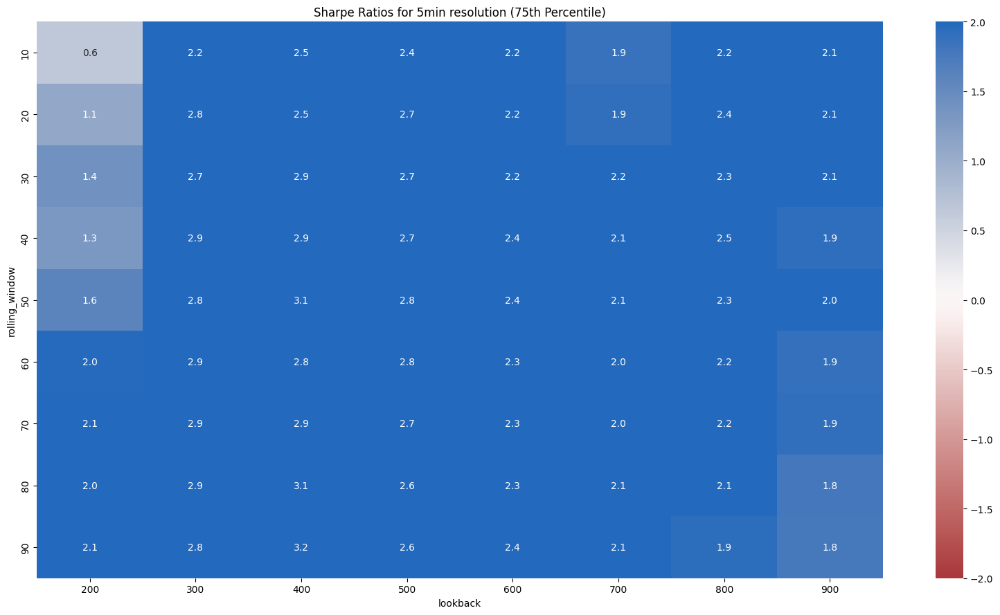

In [ ]:
display(result.query("n_trades > 10").sort_values(by='sharpe', ascending=False).iloc[:20].reset_index(drop=True))

import seaborn as sns
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(16, 9))

for freq in result.freq.unique():
    sns.heatmap(result[result['freq']==freq].pivot_table(index="rolling_window", columns="lookback", values="sharpe", aggfunc=lambda x: x.quantile(0.75)),
                cmap="vlag_r", vmax=2, vmin=-2, annot=True, fmt=".1f", ax=ax).set_title(f"Sharpe Ratios for {freq} resolution (75th Percentile)")

plt.tight_layout()
plt.show()